# 0. Importación de Librerías.

In [1]:
!pip install ydata-profiling

In [1]:
#Manejo de datos
import pandas as pd
import numpy as np

#Visualización de datos
import matplotlib.pyplot as plt
import seaborn as sns
from joblib import dump
%matplotlib inline

#Analisis profundo de datos
from ydata_profiling import ProfileReport
from pandas_profiling import ProfileReport

#Entrenamiento del modelo
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler, FunctionTransformer
from sklearn.compose import ColumnTransformer, make_column_selector

C:\Users\Julian\AppData\Local\Temp\ipykernel_13252\3456852009.py:13: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


# 1. Entendimiento del Negocio

Con base en el diccionario de datos proporcionado, la variable objetivo será el campo moroso, el cual puede tomar las siguentes 2 categorias:

- 0 -> Mora menor o igual a 15 días en los últimos 6 meses
- 1 -> Mora mayor a 15 días en los últimos 6 meses

# 2. Entendimiento de los Datos

Se cargan los datos para iniciar su exploración.

In [13]:
url = 'https://raw.githubusercontent.com/ivanrsv85/proyectoAML/main/solicitudes_tc_dataset.csv'
data = pd.read_csv(url, sep = ';')
data

,contract_number,card_type,plastic_status,virtual_status,credit_limit,workflow_type,created_at,acquisition_channel,company_type,business_dni_type,...,sherlock_banked,sherlock_collection,emailage_eascore,lc_judicial_proceedings_against,number_shareholders,os,economic_activity_group,number_employees,mora_ultimos_6meses,moroso
0,17,BUSINESS,ACTIVE,ACTIVE,30000000,FAMILY_AND_FRIENDS,10/09/21 8:54,INTERNET,SAS,NIT,...,0,0,746,0,3,Windows,SERVICIOS,67,0,0
1,21,BUSINESS,CANCELED,CANCELED,10000000,FAMILY_AND_FRIENDS,10/09/21 15:35,COMMERCIAL_ALLY,SAS,NIT,...,0,0,580,0,6,Windows,SERVICIOS,42,102,1
2,9,BUSINESS,PENDING_ACTIVATION,ACTIVE,30000000,FAMILY_AND_FRIENDS,23/07/21 16:26,INTERNET,SAS,NIT,...,0,0,694,0,4,Windows,SERVICIOS,48,0,0
3,10,BUSINESS,ACTIVE,ACTIVE,30000000,FAMILY_AND_FRIENDS,23/07/21 11:56,INTERNET,SA,NIT,...,0,0,409,0,2,Windows,SERVICIOS,33,16,1
4,19,BUSINESS,ACTIVE,ACTIVE,20000000,FAMILY_AND_FRIENDS,10/09/21 10:19,FRIEND_OR_COLLEAGUE,SAS,NIT,...,0,0,385,0,2,Windows,SERVICIOS,80,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1706,2147,BUSINESS,ACTIVE,ACTIVE,5000000,CROSS_SELLING,16/03/23 16:02,REFERRER,SAS,NIT,...,0,0,438,0,2,Windows,MANUFACTURA,13,0,0
1707,2151,BUSINESS,ACTIVE,ACTIVE,30000000,FAMILY_AND_FRIENDS,21/03/23 14:01,INTERNET,SAS,NIT,...,0,0,284,0,2,Windows,SERVICIOS,28,0,0
1708,141,BUSINESS,SECURITY_LOCKED,SECURITY_LOCKED,10000000,FAMILY_AND_FRIENDS,28/10/21 14:23,FRIEND_OR_COLLEAGUE,SAS,NIT,...,0,0,368,0,2,Windows,MANUFACTURA,14,90,1
1709,2233,BUSINESS,PENDING_ACTIVATION,ACTIVE,10000000,FAMILY_AND_FRIENDS,20/04/23 14:00,REFERRER,SAS,NIT,...,0,0,605,0,7,Windows,SERVICIOS,11,0,0


Separación de los conjuntos de entranamiento y prueba

In [142]:
train, test = train_test_split(data, test_size=0.2, random_state=33)
train

,contract_number,card_type,plastic_status,virtual_status,credit_limit,workflow_type,created_at,acquisition_channel,company_type,business_dni_type,...,sherlock_banked,sherlock_collection,emailage_eascore,lc_judicial_proceedings_against,number_shareholders,os,economic_activity_group,number_employees,mora_ultimos_6meses,moroso
1018,1541,BUSINESS,FRAUDULENT,FRAUDULENT,5000000,FAMILY_AND_FRIENDS,31/05/22 17:25,SOCIAL_NETWORKS,SAS,NIT,...,0,0,717,0,2,Windows,SERVICIOS,61,1,0
21,93,BUSINESS,ACTIVE,ACTIVE,7000000,FAMILY_AND_FRIENDS,21/10/21 16:27,REFERRER,SAS,NIT,...,0,0,546,0,1,Windows,SERVICIOS,25,38,1
270,390,BUSINESS,ACTIVE,ACTIVE,2000000,FAMILY_AND_FRIENDS,2/12/21 15:09,SOCIAL_NETWORKS,SAS,NIT,...,0,0,690,0,2,Windows,SERVICIOS,31,13,0
51,190,BUSINESS,ACTIVE,ACTIVE,10000000,FAMILY_AND_FRIENDS,27/10/21 16:19,INTERNET,SAS,NIT,...,0,0,584,0,2,Windows,MANUFACTURA,30,6,0
591,942,BUSINESS,ACTIVE,ACTIVE,20000000,FAMILY_AND_FRIENDS,8/02/22 16:16,INTERNET,SAS,NIT,...,0,0,380,0,1,Windows,SERVICIOS,80,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1225,1816,BUSINESS,ACTIVE,ACTIVE,5000000,CROSS_SELLING,22/09/22 10:08,COMMERCIAL_ALLY,SAS,NIT,...,0,0,689,11,1,Windows,SERVICIOS,63,16,1
658,972,BUSINESS,ACTIVE,ACTIVE,5000000,FAMILY_AND_FRIENDS,11/02/22 15:37,SOCIAL_NETWORKS,SAS,NIT,...,0,0,490,0,1,Windows,SERVICIOS,70,11,0
578,842,BUSINESS,PENDING_ACTIVATION,ACTIVE,10000000,FAMILY_AND_FRIENDS,28/01/22 10:04,REFERRER,SAS,NIT,...,0,0,585,0,2,Windows,SERVICIOS,37,0,0
391,489,BUSINESS,ACTIVE,ACTIVE,2000000,FAMILY_AND_FRIENDS,15/12/21 19:07,SOCIAL_NETWORKS,SAS,NIT,...,0,0,593,0,2,Windows,SERVICIOS,30,33,1


Se utiliza pandas-profiling para realizar el EDA (análisis exploratorio de datos)

In [6]:
ProfileReport(train)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

 # 3. Preparación de los datos

In [213]:
train_m, val = train_test_split(train, test_size=0.2, random_state=33)
train_m.head()

,contract_number,card_type,plastic_status,virtual_status,credit_limit,workflow_type,created_at,acquisition_channel,company_type,business_dni_type,...,sherlock_banked,sherlock_collection,emailage_eascore,lc_judicial_proceedings_against,number_shareholders,os,economic_activity_group,number_employees,mora_ultimos_6meses,moroso
1661,181,BUSINESS,ACTIVE,ACTIVE,20000000,FAMILY_AND_FRIENDS,5/11/21 12:18,SOCIAL_NETWORKS,SAS,NIT,...,0,0,576,0,1,Windows,SERVICIOS,27,2,0
1006,1518,BUSINESS,CANCELED,CANCELED,5000000,FAMILY_AND_FRIENDS,25/05/22 16:05,INTERNET,SAS,NIT,...,0,0,628,0,1,Windows,SERVICIOS,34,212,1
1692,966,BUSINESS,ACTIVE,ACTIVE,10000000,FAMILY_AND_FRIENDS,11/02/22 9:58,SOCIAL_NETWORKS,SAS,NIT,...,0,0,426,0,1,Windows,SERVICIOS,25,12,0
1223,1813,BUSINESS,PENDING_ACTIVATION,ACTIVE,2000000,CROSS_SELLING,21/09/22 12:47,COMMUNICATION_MEDIA,SAS,NIT,...,0,0,375,0,1,Windows,MANUFACTURA,73,0,0
195,253,BUSINESS,CANCELED,CANCELED,10000000,FAMILY_AND_FRIENDS,19/11/21 8:53,REFERRER,SAS,NIT,...,0,0,547,0,1,Windows,SERVICIOS,15,0,0


In [219]:
data2=data.drop(['moroso'],axis=1)

## Variables a eliminar 
* contract_number: Es un identificador del contrato
* card_type: Es una variable única
* business_dni_type: Variable única
* city: Tiene alta correlación con departamento
* mora_ultimos_6meses: esta totalmente relacionanda con la variable objetivo.




## Variables a transformar
* crated_at: Tiempo de antiguedad
* plastic_status: Variable categórica
* virtual_status: Variable categórica
* workflow_type: Variable categórica
* acquisition_channel: Variable categórica
* company_type: Variable categórica
* business_website: Variable categórica
* department: Variable categórica
* sherlock_reactivate: variable booleana
* os: Variable categórica
* economic_activity_group: Variable categórica
* sherlock_operator: Variable categórica


In [220]:
def eliminar_columnas_no_utiles(X):
    columnas_no_utiles = ['contract_number','card_type','business_dni_type','city','mora_ultimos_6meses','created_at']
    return X.drop(columnas_no_utiles, axis=1)

preprocessor = ColumnTransformer(
    transformers=[
        ("num", StandardScaler(),  make_column_selector(dtype_include=np.number)),
        ("cat", OneHotEncoder(), make_column_selector(dtype_include=object)),
    ]
)
pipe = Pipeline(steps=[
    ('eliminar_columnas', FunctionTransformer(eliminar_columnas_no_utiles)),
    ('column_transformer',preprocessor)
])

pipe.fit(data2)

Pipeline(steps=[('eliminar_columnas',
                 FunctionTransformer(func=<function eliminar_columnas_no_utiles at 0x000001A01187B550>)),
                ('column_transformer',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x000001A011D13E20>),
                                                 ('cat', OneHotEncoder(),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x000001A011C7FC10>)]))])

In [349]:
joblib.dump(pipe, 'pipeline.pkl')

['pipeline.pkl']

In [249]:
cat_names = pipe['column_transformer'].transformers_[1][1].get_feature_names_out()
num_names = pipe['column_transformer'].transformers_[0][1].feature_names_in_
col_names = list(num_names) + list(cat_names)
col_names

['credit_limit',
 'business_foundation_year',
 'bureau_score',
 'banked_type1',
 'banked_type2',
 'hard_credit_check',
 'number_saving_accounts',
 'number_saving_accounts_alert',
 'bureau_debt',
 'bureau_debt_default',
 'number_current_loans',
 'number_current_loans_default',
 'sherlock_anomaly',
 'sherlock_distrust',
 'sherlock_banked',
 'sherlock_collection',
 'emailage_eascore',
 'lc_judicial_proceedings_against',
 'number_shareholders',
 'number_employees',
 'plastic_status_ACTIVE',
 'plastic_status_CANCELED',
 'plastic_status_FRAUDULENT',
 'plastic_status_LOST',
 'plastic_status_PENDING_ACTIVATION',
 'plastic_status_PREVENTIVELY_LOCKED',
 'plastic_status_REPLACED',
 'plastic_status_SECURITY_LOCKED',
 'plastic_status_STOLEN',
 'virtual_status_ACTIVE',
 'virtual_status_CANCELED',
 'virtual_status_FRAUDULENT',
 'virtual_status_LOST',
 'virtual_status_PREVENTIVELY_LOCKED',
 'virtual_status_REPLACED',
 'virtual_status_SECURITY_LOCKED',
 'virtual_status_STOLEN',
 'workflow_type_BUSINESS

In [254]:
X_train, y_train = train_m.drop(['moroso'],axis=1), train_m['moroso'] 
display(X_train)
y_train   

,contract_number,card_type,plastic_status,virtual_status,credit_limit,workflow_type,created_at,acquisition_channel,company_type,business_dni_type,...,sherlock_reactivate,sherlock_banked,sherlock_collection,emailage_eascore,lc_judicial_proceedings_against,number_shareholders,os,economic_activity_group,number_employees,mora_ultimos_6meses
1661,181,BUSINESS,ACTIVE,ACTIVE,20000000,FAMILY_AND_FRIENDS,5/11/21 12:18,SOCIAL_NETWORKS,SAS,NIT,...,False,0,0,576,0,1,Windows,SERVICIOS,27,2
1006,1518,BUSINESS,CANCELED,CANCELED,5000000,FAMILY_AND_FRIENDS,25/05/22 16:05,INTERNET,SAS,NIT,...,False,0,0,628,0,1,Windows,SERVICIOS,34,212
1692,966,BUSINESS,ACTIVE,ACTIVE,10000000,FAMILY_AND_FRIENDS,11/02/22 9:58,SOCIAL_NETWORKS,SAS,NIT,...,False,0,0,426,0,1,Windows,SERVICIOS,25,12
1223,1813,BUSINESS,PENDING_ACTIVATION,ACTIVE,2000000,CROSS_SELLING,21/09/22 12:47,COMMUNICATION_MEDIA,SAS,NIT,...,False,0,0,375,0,1,Windows,MANUFACTURA,73,0
195,253,BUSINESS,CANCELED,CANCELED,10000000,FAMILY_AND_FRIENDS,19/11/21 8:53,REFERRER,SAS,NIT,...,False,0,0,547,0,1,Windows,SERVICIOS,15,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1043,1586,BUSINESS,SECURITY_LOCKED,SECURITY_LOCKED,10000000,FAMILY_AND_FRIENDS,24/06/22 10:47,FRIEND_OR_COLLEAGUE,SAS,NIT,...,False,0,0,684,0,1,Windows,SERVICIOS,23,7
706,1055,BUSINESS,ACTIVE,ACTIVE,10000000,FAMILY_AND_FRIENDS,22/02/22 18:16,INTERNET,SAS,NIT,...,False,0,0,536,0,1,Windows,SERVICIOS,72,90
653,944,BUSINESS,PENDING_ACTIVATION,ACTIVE,5000000,FAMILY_AND_FRIENDS,9/02/22 17:44,FRIEND_OR_COLLEAGUE,SAS,NIT,...,False,0,0,749,0,3,Windows,SERVICIOS,42,11
446,685,BUSINESS,ACTIVE,ACTIVE,2000000,FAMILY_AND_FRIENDS,6/01/22 16:05,FRIEND_OR_COLLEAGUE,SAS,NIT,...,False,0,0,527,0,2,Windows,SERVICIOS,67,3


1661    0
1006    1
1692    0
1223    0
195     0
       ..
1043    0
706     1
653     0
446     0
861     1
Name: moroso, Length: 1094, dtype: int64

In [255]:
def convertir(X):
    df_1=pd.DataFrame.sparse.from_spmatrix(pipe.transform(X))
    df_1.columns = col_names
    return df_1

In [256]:
X_train=convertir(X_train)
X_train

,credit_limit,business_foundation_year,bureau_score,banked_type1,banked_type2,hard_credit_check,number_saving_accounts,number_saving_accounts_alert,bureau_debt,bureau_debt_default,...,sherlock_operator_wom,os_Android,os_Linux,os_Macintosh,os_Windows,os_iPhone,economic_activity_group_COMERCIO,economic_activity_group_MANUFACTURA,economic_activity_group_OTRAS INDUSTRIAS,economic_activity_group_SERVICIOS
0,1.375694,0.819303,0.739047,0.499817,0.812129,0.726534,-0.036154,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1,-0.544009,0.819303,-0.040878,-2.000731,-1.231331,-0.080674,-0.036154,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
2,0.095892,0.819303,0.940317,0.499817,0.812129,0.726534,-1.018049,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
3,-0.927950,-1.123632,0.827103,0.499817,0.812129,-0.887881,-1.018049,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
4,0.095892,-0.152164,-1.801997,-2.000731,-1.231331,-0.887881,-0.036154,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1089,0.095892,0.819303,-0.757905,0.499817,0.812129,-0.080674,-1.018049,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1090,0.095892,0.625010,1.481233,-2.000731,-1.231331,-0.080674,-0.036154,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1091,-0.544009,-0.152164,1.317700,0.499817,0.812129,0.726534,-1.018049,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1092,-0.927950,1.013596,0.349085,0.499817,0.812129,-0.080674,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0


In [257]:
X_val, y_val = val.drop(['moroso'],axis=1), val['moroso'] 
display(X_val)
y_val   

,contract_number,card_type,plastic_status,virtual_status,credit_limit,workflow_type,created_at,acquisition_channel,company_type,business_dni_type,...,sherlock_reactivate,sherlock_banked,sherlock_collection,emailage_eascore,lc_judicial_proceedings_against,number_shareholders,os,economic_activity_group,number_employees,mora_ultimos_6meses
899,1436,BUSINESS,ACTIVE,ACTIVE,16000000,CURRENT_CUSTOMER,23/04/22 10:00,INTERNET,SAS,NIT,...,False,0,0,719,0,1,Windows,SERVICIOS,69,3
1202,1761,BUSINESS,ACTIVE,ACTIVE,20000000,CROSS_SELLING,7/09/22 16:04,INTERNET,SAS,NIT,...,False,0,0,733,0,1,Windows,MANUFACTURA,37,7
1157,1709,BUSINESS,ACTIVE,ACTIVE,5000000,CROSS_SELLING,24/08/22 17:37,COMMUNICATION_MEDIA,SAS,NIT,...,False,0,0,459,0,1,Windows,SERVICIOS,59,12
658,972,BUSINESS,ACTIVE,ACTIVE,5000000,FAMILY_AND_FRIENDS,11/02/22 15:37,SOCIAL_NETWORKS,SAS,NIT,...,False,0,0,490,0,1,Windows,SERVICIOS,70,11
300,432,BUSINESS,ACTIVE,ACTIVE,10000000,CURRENT_CUSTOMER,2/12/21 18:10,INTERNET,SAS,NIT,...,False,0,0,506,0,2,Windows,COMERCIO,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1163,1727,BUSINESS,ACTIVE,ACTIVE,10000000,BUSINESS,24/08/22 8:46,SOCIAL_NETWORKS,SAS,NIT,...,True,1,1,262,0,2,iPhone,SERVICIOS,1,7
216,333,BUSINESS,ACTIVE,ACTIVE,2000000,FAMILY_AND_FRIENDS,1/12/21 17:26,COMMERCIAL_ALLY,SAS,NIT,...,False,0,0,432,0,3,Windows,SERVICIOS,12,7
11,81,BUSINESS,ACTIVE,ACTIVE,30000000,FAMILY_AND_FRIENDS,13/10/21 10:13,FRIEND_OR_COLLEAGUE,SAS,NIT,...,False,0,0,356,0,4,Windows,SERVICIOS,22,13
550,815,BUSINESS,ACTIVE,ACTIVE,2000000,BUSINESS,21/01/22 23:30,SOCIAL_NETWORKS,SAS,NIT,...,True,1,1,390,0,1,Windows,MANUFACTURA,6,3


899     0
1202    0
1157    0
658     0
300     0
       ..
1163    0
216     0
11      0
550     0
1361    0
Name: moroso, Length: 274, dtype: int64

In [258]:
X_val=convertir(X_val)
X_val

,credit_limit,business_foundation_year,bureau_score,banked_type1,banked_type2,hard_credit_check,number_saving_accounts,number_saving_accounts_alert,bureau_debt,bureau_debt_default,...,sherlock_operator_wom,os_Android,os_Linux,os_Macintosh,os_Windows,os_iPhone,economic_activity_group_COMERCIO,economic_activity_group_MANUFACTURA,economic_activity_group_OTRAS INDUSTRIAS,economic_activity_group_SERVICIOS
0,0.863773,-0.735045,-0.393101,0.499817,-1.231331,-0.887881,0.945741,-0.034209,0.244915,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1,1.375694,-0.735045,1.971830,0.499817,0.812129,0.726534,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
2,-0.544009,1.013596,-1.122708,0.499817,0.812129,-0.080674,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
3,-0.544009,-0.152164,-0.632111,0.499817,0.812129,0.726534,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
4,0.095892,0.625010,-0.518896,0.499817,-1.231331,-0.887881,-0.036154,-0.034209,0.547162,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
269,0.095892,0.236423,-0.305046,0.499817,-1.231331,0.726534,-0.036154,-0.034209,-0.132667,-0.03595,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
270,-0.927950,-0.152164,-1.059811,0.499817,0.812129,-0.080674,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
271,2.655496,-0.152164,0.361664,0.499817,0.812129,-0.080674,-1.018049,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
272,-0.927950,-0.929338,0.877420,0.499817,0.812129,-0.080674,0.945741,-0.034209,0.281567,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


# 4. Modelamiento

In [23]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import recall_score, make_scorer
from sklearn.model_selection import GridSearchCV

ImportError: cannot import name 'sparse_lsqr' from 'sklearn.utils.fixes' (C:\Users\Julian\anaconda3\envs\MachineLearning\lib\site-packages\sklearn\utils\fixes.py)

## 4.1 Modelo base de regresión logistica

In [352]:
model_LR = LogisticRegression(max_iter=1000)

model_LR.fit(X_train, y_train)

y_pred_LR = model_LR.predict(X_val)

# Paso 5: Calcular el recall
recall = recall_score(y_val, y_pred_LR)
print("Recall del modelo: {:.2f}".format(recall))

Recall del modelo: 0.69


## 4.2 Modelo base Árbol de decisión

In [353]:
# Crear el modelo de árbol de decisión
model_DT = DecisionTreeClassifier()

# Entrenar el modelo
model_DT.fit(X_train, y_train)

# Realizar predicciones en el conjunto de prueba
y_pred_DT = model_DT.predict(X_val)

# Calcular la precisión del modelo
recall = recall_score(y_val, y_pred_DT)
print("Recall del modelo: {:.2f}".format(recall))

Recall del modelo: 0.74


## 4.3 Modelo base Radom Forest

In [354]:
# Crear el modelo de Random Forest
model_RF = RandomForestClassifier()

# Entrenar el modelo
model_RF.fit(X_train, y_train)

# Realizar predicciones en el conjunto de prueba
y_pred_RF = model_RF.predict(X_val)

# Calcular la precisión del modelo
recall = recall_score(y_val, y_pred_RF)
print("Recall del modelo: {:.2f}".format(recall))

Recall del modelo: 0.69


## 4.4 Modelo base SVM

In [355]:
# Crear el modelo SVM
model_SVM = SVC()

# Entrenar el modelo
model_SVM.fit(X_train.values, y_train)

# Realizar predicciones en el conjunto de prueba
y_pred_SVM = model_SVM.predict(X_val.values)

# Calcular la precisión del modelo
recall = recall_score(y_val, y_pred_SVM)
print("Recall del modelo: {:.2f}".format(recall))

Recall del modelo: 0.68


## 4.5 Modelo base Gradient Boosting

In [356]:
# Crear el modelo Gradient Boosting
model_GB = GradientBoostingClassifier()

# Entrenar el modelo
model_GB.fit(X_train, y_train)

# Realizar predicciones en el conjunto de prueba
y_pred_GB = model_GB.predict(X_val)

# Calcular la precisión del modelo
recall = recall_score(y_val, y_pred_GB)
print("Recall del modelo: {:.2f}".format(recall))

Recall del modelo: 0.71


Se realiza cross validation y Grid search para Random Forest, SVM y Gradient Booting

# 5. Busqueda de hiperparámetros

In [357]:
X_test, y_test = test.drop(['moroso'],axis=1), test['moroso'] 
display(X_test)
y_test 

,contract_number,card_type,plastic_status,virtual_status,credit_limit,workflow_type,created_at,acquisition_channel,company_type,business_dni_type,...,sherlock_reactivate,sherlock_banked,sherlock_collection,emailage_eascore,lc_judicial_proceedings_against,number_shareholders,os,economic_activity_group,number_employees,mora_ultimos_6meses
476,740,BUSINESS,CANCELED,CANCELED,10000000,FAMILY_AND_FRIENDS,28/12/21 10:17,INTERNET,SAS,NIT,...,False,0,0,667,0,2,Windows,MANUFACTURA,52,303
830,1259,BUSINESS,ACTIVE,ACTIVE,20000000,FAMILY_AND_FRIENDS,11/03/22 21:11,SOCIAL_NETWORKS,SAS,NIT,...,False,0,0,296,0,1,Windows,SERVICIOS,54,0
1594,1984,BUSINESS,ACTIVE,ACTIVE,10000000,CROSS_SELLING,12/12/22 11:22,COMMERCIAL_ALLY,SAS,NIT,...,False,0,0,377,0,1,Windows,SERVICIOS,34,0
1120,1677,BUSINESS,PENDING_ACTIVATION,ACTIVE,5000000,FAMILY_AND_FRIENDS,11/08/22 15:28,FRIEND_OR_COLLEAGUE,SAS,NIT,...,False,0,0,592,0,1,Windows,SERVICIOS,12,0
1208,1803,BUSINESS,ACTIVE,ACTIVE,2000000,BUSINESS,14/09/22 14:37,INTERNET,SAS,NIT,...,True,1,0,483,0,1,Windows,COMERCIO,66,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1009,1689,BUSINESS,ACTIVE,ACTIVE,20000000,BUSINESS,29/05/22 10:03,SOCIAL_NETWORKS,SAS,NIT,...,True,1,1,655,0,1,Windows,SERVICIOS,7,0
424,592,BUSINESS,ACTIVE,ACTIVE,5000000,FAMILY_AND_FRIENDS,17/12/21 10:22,COMMUNICATION_MEDIA,SAS,NIT,...,False,0,0,394,0,2,Windows,SERVICIOS,64,5
518,733,BUSINESS,ACTIVE,ACTIVE,5000000,FAMILY_AND_FRIENDS,14/01/22 7:50,SOCIAL_NETWORKS,SAS,NIT,...,False,0,0,414,0,1,Windows,SERVICIOS,11,0
539,797,BUSINESS,ACTIVE,ACTIVE,5000000,BUSINESS,18/01/22 12:30,INTERNET,SAS,NIT,...,True,1,0,590,0,4,Windows,MANUFACTURA,37,6


476     1
830     0
1594    0
1120    0
1208    0
       ..
1009    0
424     0
518     0
539     0
977     0
Name: moroso, Length: 343, dtype: int64

In [358]:
X_test=convertir(X_test)
X_test

,credit_limit,business_foundation_year,bureau_score,banked_type1,banked_type2,hard_credit_check,number_saving_accounts,number_saving_accounts_alert,bureau_debt,bureau_debt_default,...,sherlock_operator_wom,os_Android,os_Linux,os_Macintosh,os_Windows,os_iPhone,economic_activity_group_COMERCIO,economic_activity_group_MANUFACTURA,economic_activity_group_OTRAS INDUSTRIAS,economic_activity_group_SERVICIOS
0,0.095892,0.430716,-1.084970,-2.000731,-1.231331,0.726534,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,1.375694,0.236423,-1.361717,0.499817,0.812129,-0.080674,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
2,0.095892,0.819303,1.619606,0.499817,0.812129,-0.887881,-0.036154,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
3,-0.544009,-0.346458,-0.355363,0.499817,0.812129,-0.887881,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
4,-0.927950,-3.260860,0.022020,0.499817,-1.231331,-0.887881,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
338,1.375694,-1.512219,2.223419,0.499817,0.812129,-0.080674,1.927636,-0.034209,2.960168,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
339,-0.544009,-1.317925,1.217065,0.499817,0.812129,0.726534,-1.018049,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
340,-0.544009,0.430716,-1.424614,0.499817,0.812129,0.726534,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
341,-0.544009,-0.540751,0.474879,0.499817,0.812129,2.340948,1.927636,-0.034209,1.698058,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


## 5.2 Modelo Árbol de decisión con cross validation y Grid Search


In [428]:
# Crear el clasificador de Árbol de Decisión
dt_classifier = DecisionTreeClassifier()

# Definir los hiperparámetros a probar en la búsqueda de cuadrícula
param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2'],
    'class_weight': [None,'balanced']
}

scoring = make_scorer(recall_score)

# Realizar la búsqueda de cuadrícula con validación cruzada
grid_search = GridSearchCV(dt_classifier, param_grid, cv=5, scoring=scoring, verbose=10)
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 432 candidates, totalling 2160 fits
[CV 1/5; 1/432] START class_weight=None, criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2
[CV 1/5; 1/432] END class_weight=None, criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2;, score=0.655 total time=   0.0s
[CV 2/5; 1/432] START class_weight=None, criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2
[CV 2/5; 1/432] END class_weight=None, criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2;, score=0.782 total time=   0.0s
[CV 3/5; 1/432] START class_weight=None, criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2
[CV 3/5; 1/432] END class_weight=None, criterion=gini, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2;, score=0.696 total time=   0.0s
[CV 4/5; 1/432] START class_weight=None, criterion=

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'class_weight': [None, 'balanced'],
                         'criterion': ['gini', 'entropy'],
                         'max_depth': [None, 5, 10, 20],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10]},
             scoring=make_scorer(recall_score), verbose=10)

In [429]:
# Mostrar el estado del grid search
print("Mejores parámetros encontrados:")
print(grid_search.best_params_)
print("Mejor puntuación de la métrica:", grid_search.best_score_)

# Realizar predicciones en el conjunto de prueba con el mejor modelo
y_pred = best_model.predict(X_val)

# Calcular la métrica en el conjunto de validación
metric_value = recall_score(y_val, y_pred)
print("Valor de la métrica en el conjunto de prueba:", metric_value)

Mejores parámetros encontrados:
{'class_weight': 'balanced', 'criterion': 'entropy', 'max_depth': 5, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 2}
Mejor puntuación de la métrica: 0.8990259740259742
Valor de la métrica en el conjunto de prueba: 0.7692307692307693


## 5.3 Modelo Random Forest con cross validation y Grid Search

In [424]:
# Definir los hiperparámetros a probar en la búsqueda de cuadrícula
param_grid = {
    'n_estimators': [10, 50, 100, 200],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 4, 6, 8, 10],
    'class_weight': [None,'balanced', 'balanced_subsample']
}

# Crear el clasificador de Random Forest
rf_classifier = RandomForestClassifier()

# Definir la métrica de evaluación que deseas utilizar
scoring = make_scorer(recall_score)

# Realizar la búsqueda de cuadrícula con validación cruzada
grid_search = GridSearchCV(rf_classifier, param_grid, cv=5, scoring=scoring, verbose=10)
grid_search.fit(X_train, y_train)

# Obtener el mejor modelo encontrado por la búsqueda de cuadrícula
best_model = grid_search.best_estimator_


Fitting 5 folds for each of 120 candidates, totalling 600 fits
[CV 1/5; 1/120] START class_weight=balanced, max_depth=None, min_samples_split=2, n_estimators=10
[CV 1/5; 1/120] END class_weight=balanced, max_depth=None, min_samples_split=2, n_estimators=10;, score=0.636 total time=   0.3s
[CV 2/5; 1/120] START class_weight=balanced, max_depth=None, min_samples_split=2, n_estimators=10
[CV 2/5; 1/120] END class_weight=balanced, max_depth=None, min_samples_split=2, n_estimators=10;, score=0.764 total time=   0.0s
[CV 3/5; 1/120] START class_weight=balanced, max_depth=None, min_samples_split=2, n_estimators=10
[CV 3/5; 1/120] END class_weight=balanced, max_depth=None, min_samples_split=2, n_estimators=10;, score=0.732 total time=   0.0s
[CV 4/5; 1/120] START class_weight=balanced, max_depth=None, min_samples_split=2, n_estimators=10
[CV 4/5; 1/120] END class_weight=balanced, max_depth=None, min_samples_split=2, n_estimators=10;, score=0.679 total time=   0.1s
[CV 5/5; 1/120] START class_w

In [425]:
# Mostrar el estado del grid search
print("Mejores parámetros encontrados:")
print(grid_search.best_params_)
print("Mejor puntuación de la métrica:", grid_search.best_score_)

# Realizar predicciones en el conjunto de prueba con el mejor modelo
y_pred = best_model.predict(X_val)

# Calcular la métrica en el conjunto de validación
metric_value = recall_score(y_val, y_pred)
print("Valor de la métrica en el conjunto de prueba:", metric_value)

Mejores parámetros encontrados:
{'class_weight': 'balanced', 'max_depth': 5, 'min_samples_split': 4, 'n_estimators': 10}
Mejor puntuación de la métrica: 0.8196753246753247
Valor de la métrica en el conjunto de prueba: 0.7692307692307693


In [363]:
# Realizar predicciones en el conjunto de prueba con el mejor modelo
y_pred = best_model.predict(X_test)

# Calcular la métrica en el conjunto de prueba
metric_value = recall_score(y_test, y_pred)
print("Valor de la métrica en el conjunto de prueba:", metric_value)

Valor de la métrica en el conjunto de prueba: 0.7534246575342466


## 5.4 Modelo SVM con cross validation y Grid Search

In [439]:
# Definir los hiperparámetros a probar en la búsqueda de cuadrícula
param_grid = {
    'C': [0.1, 1, 10],
    'kernel': ['linear', 'rbf','poly'],
    'class_weight': [None,'balanced']
}

# Crear el clasificador de SVM
svm_classifier = SVC()

# Definir la métrica de evaluación que deseas utilizar
scoring = make_scorer(recall_score)

# Realizar la búsqueda de cuadrícula con validación cruzada
grid_search = GridSearchCV(svm_classifier, param_grid, cv=5, scoring=scoring, n_jobs=-1,  verbose=10)
grid_search.fit(X_train.values, y_train)


Fitting 5 folds for each of 18 candidates, totalling 90 fits


GridSearchCV(cv=5, estimator=SVC(), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10], 'class_weight': [None, 'balanced'],
                         'kernel': ['linear', 'rbf', 'poly']},
             scoring=make_scorer(recall_score), verbose=10)

In [440]:
# Obtener el mejor modelo encontrado por la búsqueda de cuadrícula
best_model = grid_search.best_estimator_

# Mostrar el estado del grid search
print("Mejores parámetros encontrados:")
print(grid_search.best_params_)
print("Mejor puntuación de la métrica:", grid_search.best_score_)

# Realizar predicciones en el conjunto de prueba con el mejor modelo
y_pred = best_model.predict(X_val.values)

# Calcular la métrica en el conjunto de prueba
metric_value = recall_score(y_val, y_pred)
print("Valor de la métrica en el conjunto de prueba:", metric_value)

Mejores parámetros encontrados:
{'C': 0.1, 'class_weight': 'balanced', 'kernel': 'linear'}
Mejor puntuación de la métrica: 0.8596753246753247
Valor de la métrica en el conjunto de prueba: 0.7948717948717948


In [441]:
import joblib

# Guardar el modelo en un archivo
joblib.dump(best_model, 'SVM.pkl')

['SVM.pkl']

## 5.5  Modelo Gradient Boosting con cross validation y Grid Search

In [435]:
# Crear el modelo Gradient Boosting
model_GB = GradientBoostingClassifier()

# Definir los hiperparámetros a probar en la búsqueda de cuadrícula
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.1, 0.01, 0.001],
    'max_depth': [3, 5, 10],
}

# Definir la métrica de evaluación que deseas utilizar
scoring = make_scorer(recall_score)

# Realizar la búsqueda de cuadrícula con validación cruzada
grid_search = GridSearchCV(model_GB, param_grid, cv=5, scoring=scoring, verbose=10)
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 27 candidates, totalling 135 fits
[CV 1/5; 1/27] START learning_rate=0.1, max_depth=3, n_estimators=50............
[CV 1/5; 1/27] END learning_rate=0.1, max_depth=3, n_estimators=50;, score=0.691 total time=   2.5s
[CV 2/5; 1/27] START learning_rate=0.1, max_depth=3, n_estimators=50............
[CV 2/5; 1/27] END learning_rate=0.1, max_depth=3, n_estimators=50;, score=0.782 total time=   0.3s
[CV 3/5; 1/27] START learning_rate=0.1, max_depth=3, n_estimators=50............
[CV 3/5; 1/27] END learning_rate=0.1, max_depth=3, n_estimators=50;, score=0.750 total time=   0.3s
[CV 4/5; 1/27] START learning_rate=0.1, max_depth=3, n_estimators=50............
[CV 4/5; 1/27] END learning_rate=0.1, max_depth=3, n_estimators=50;, score=0.732 total time=   0.3s
[CV 5/5; 1/27] START learning_rate=0.1, max_depth=3, n_estimators=50............
[CV 5/5; 1/27] END learning_rate=0.1, max_depth=3, n_estimators=50;, score=0.782 total time=   0.2s
[CV 1/5; 2/27] START learning_rat

GridSearchCV(cv=5, estimator=GradientBoostingClassifier(),
             param_grid={'learning_rate': [0.1, 0.01, 0.001],
                         'max_depth': [3, 5, 10],
                         'n_estimators': [50, 100, 200]},
             scoring=make_scorer(recall_score), verbose=10)

In [436]:
# Obtener el mejor modelo encontrado por la búsqueda de cuadrícula
best_model = grid_search.best_estimator_

# Mostrar el estado del grid search
print("Mejores parámetros encontrados:")
print(grid_search.best_params_)
print("Mejor puntuación de la métrica:", grid_search.best_score_)

# Realizar predicciones en el conjunto de prueba con el mejor modelo
y_pred = best_model.predict(X_val)

# Calcular la métrica en el conjunto de prueba
metric_value = recall_score(y_val, y_pred)
print("Valor de la métrica en el conjunto de prueba:", metric_value)

Mejores parámetros encontrados:
{'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 50}
Mejor puntuación de la métrica: 0.7511038961038962
Valor de la métrica en el conjunto de prueba: 0.7051282051282052


# 6. Hibridación de modelos

## 6.1 Hibridación de modelos por Voting

In [437]:
from sklearn.ensemble import VotingClassifier

# Definir los modelos individuales
model1 = RandomForestClassifier(max_depth = 10, 
                                min_samples_split = 6,
                                n_estimators = 10,
                                class_weight = 'balanced')
model2 = DecisionTreeClassifier(criterion = 'gini', 
                                max_depth = 20, 
                                max_features = 'sqrt',
                                min_samples_leaf = 4, 
                                min_samples_split= 5,
                                class_weight = 'balanced')

# Crear el modelo de votación
voting_model = VotingClassifier(estimators=[('model1', model1), ('model2', model2)])

# Entrenar el modelo de votación
voting_model.fit(X_train, y_train)

# Realizar predicciones con el modelo de votación
y_pred_h = voting_model.predict(X_val)

In [438]:
# Calcular la métrica en el conjunto de prueba
metric_value = recall_score(y_val, y_pred_h)
print("Valor de la métrica en el conjunto de prueba:", metric_value)

Valor de la métrica en el conjunto de prueba: 0.717948717948718


## 6.2 Hibridación de modelos por Stacking

In [394]:
from sklearn.ensemble import StackingClassifier

In [395]:
# Crear el clasificador de apilamiento
stacking_classifier = StackingClassifier(
    estimators=[('rf', model1), ('dt', model2)],
    final_estimator=LogisticRegression()  # Modelo final para combinar las predicciones
)

# Entrenar el modelo de apilamiento
stacking_classifier.fit(X_train, y_train)

StackingClassifier(estimators=[('rf',
                                RandomForestClassifier(max_depth=10,
                                                       min_samples_split=6,
                                                       n_estimators=10)),
                               ('dt',
                                DecisionTreeClassifier(max_depth=20,
                                                       max_features='sqrt',
                                                       min_samples_leaf=4,
                                                       min_samples_split=5))],
                   final_estimator=LogisticRegression())

In [397]:
# Realizar predicciones en el conjunto de prueba
y_pred_2 = stacking_classifier.predict(X_val)
# Calcular la métrica en el conjunto de prueba
metric_value = recall_score(y_val, y_pred_2)
print("Valor de la métrica en el conjunto de prueba:", metric_value)

Valor de la métrica en el conjunto de prueba: 0.7051282051282052


In [398]:
# Realizar predicciones en el conjunto de prueba
y_pred_2 = stacking_classifier.predict(X_test)
# Calcular la métrica en el conjunto de prueba
metric_value = recall_score(y_test, y_pred_2)
print("Valor de la métrica en el conjunto de prueba:", metric_value)

Valor de la métrica en el conjunto de prueba: 0.6986301369863014


# 7. Aplicación PCA

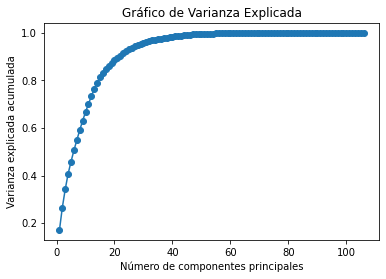

In [404]:
from sklearn.decomposition import PCA
import numpy as np
import matplotlib.pyplot as plt

# Realizar PCA
pca = PCA()
pca.fit(X_train.values)

# Obtener la varianza explicada acumulada
var_exp = np.cumsum(pca.explained_variance_ratio_)

# Graficar la varianza explicada acumulada
plt.plot(range(1, len(var_exp) + 1), var_exp, marker='o')
plt.xlabel('Número de componentes principales')
plt.ylabel('Varianza explicada acumulada')
plt.title('Gráfico de Varianza Explicada')
plt.show()

In [422]:
# Definir los pasos del pipeline
steps = [
    ('pca', PCA(n_components=80)),
    ('classifier', DecisionTreeClassifier(criterion = 'gini', 
                                          max_depth = 20, 
                                          max_features = 'sqrt',
                                          min_samples_leaf = 4, 
                                          min_samples_split= 5))  # Modelo base
]

# Crea el pipeline
pipeline_2 = Pipeline(steps)

In [423]:
# Entrena el modelo
pipeline_2.fit(X_train.values, y_train)

# Realiza predicciones en el conjunto de prueba
y_pred = pipeline_2.predict(X_val.values)

# Evalúa el modelo
accuracy = recall_score(y_val, y_pred)
print("Precisión del modelo: {:.2f}".format(accuracy))

Precisión del modelo: 0.60


# 8. Carga del modelo

In [3]:
import joblib

In [5]:
def eliminar_columnas_no_utiles(X):
    columnas_no_utiles = ['contract_number','card_type','business_dni_type','city','mora_ultimos_6meses','created_at']
    return X.drop(columnas_no_utiles, axis=1)

In [19]:
pipeline = joblib.load('./models/pipeline_Nuevo.pkl')

In [11]:
col_names = ['credit_limit',
 'business_foundation_year',
 'bureau_score',
 'banked_type1',
 'banked_type2',
 'hard_credit_check',
 'number_saving_accounts',
 'number_saving_accounts_alert',
 'bureau_debt',
 'bureau_debt_default',
 'number_current_loans',
 'number_current_loans_default',
 'sherlock_anomaly',
 'sherlock_distrust',
 'sherlock_banked',
 'sherlock_collection',
 'emailage_eascore',
 'lc_judicial_proceedings_against',
 'number_shareholders',
 'number_employees',
 'plastic_status_ACTIVE',
 'plastic_status_CANCELED',
 'plastic_status_FRAUDULENT',
 'plastic_status_LOST',
 'plastic_status_PENDING_ACTIVATION',
 'plastic_status_PREVENTIVELY_LOCKED',
 'plastic_status_REPLACED',
 'plastic_status_SECURITY_LOCKED',
 'plastic_status_STOLEN',
 'virtual_status_ACTIVE',
 'virtual_status_CANCELED',
 'virtual_status_FRAUDULENT',
 'virtual_status_LOST',
 'virtual_status_PREVENTIVELY_LOCKED',
 'virtual_status_REPLACED',
 'virtual_status_SECURITY_LOCKED',
 'virtual_status_STOLEN',
 'workflow_type_BUSINESS',
 'workflow_type_CROSS_SELLING',
 'workflow_type_CURRENT_CUSTOMER',
 'workflow_type_FAMILY_AND_FRIENDS',
 'acquisition_channel_COMMERCIAL_ALLY',
 'acquisition_channel_COMMUNICATION_MEDIA',
 'acquisition_channel_CREDIT_PROFESSIONAL_CONTACT',
 'acquisition_channel_DIRECTO',
 'acquisition_channel_ECONOMIC_MAGAZINE',
 'acquisition_channel_EMAIL',
 'acquisition_channel_EVENTS',
 'acquisition_channel_EXTERNAL_ADVERTISING',
 'acquisition_channel_FRIEND_OR_COLLEAGUE',
 'acquisition_channel_GOOGLE_SEARCH',
 'acquisition_channel_INTERNET',
 'acquisition_channel_INTERNET_ADD',
 'acquisition_channel_KNOW_SOMEONE_FROM_SEMPLI',
 'acquisition_channel_NEWSPAPERS',
 'acquisition_channel_OTHER',
 'acquisition_channel_REFERRER',
 'acquisition_channel_SOCIAL_NETWORKS',
 'acquisition_channel_SPECIALIZED_ARTICLE',
 'company_type_LTDA',
 'company_type_OTHER',
 'company_type_SA',
 'company_type_SAS',
 'business_website_no tiene',
 'business_website_tiene',
 'department_Antioquia',
 'department_Archipiélago de san andrés, providencia y santa catalina',
 'department_Atlántico',
 'department_Bogotá',
 'department_Bolívar',
 'department_Boyacá',
 'department_Caldas',
 'department_Caquetá',
 'department_Casanare',
 'department_Cauca',
 'department_Cesar',
 'department_Cundinamarca',
 'department_Córdoba',
 'department_Huila',
 'department_Magdalena',
 'department_Meta',
 'department_Nariño',
 'department_Norte de santander',
 'department_Quindío',
 'department_Risaralda',
 'department_Santander',
 'department_Tolima',
 'department_Valle del cauca',
 'sherlock_operator_claro',
 'sherlock_operator_etb',
 'sherlock_operator_exito',
 'sherlock_operator_flash mobile',
 'sherlock_operator_lov',
 'sherlock_operator_movistar',
 'sherlock_operator_tigo',
 'sherlock_operator_virgin',
 'sherlock_operator_wom',
 'os_Android',
 'os_Linux',
 'os_Macintosh',
 'os_Windows',
 'os_iPhone',
 'economic_activity_group_COMERCIO',
 'economic_activity_group_MANUFACTURA',
 'economic_activity_group_OTRAS INDUSTRIAS',
 'economic_activity_group_SERVICIOS']

In [ ]:
# cat_names = pipeline['column_transformer'].transformers_[1][1].get_feature_names_out()
# num_names = pipeline['column_transformer'].transformers_[0][1].feature_names_in_
# col_names = list(num_names) + list(cat_names)


In [20]:
def convertir(X):
    df_1=pd.DataFrame.sparse.from_spmatrix(pipeline.transform(X))
    df_1.columns = col_names
    return df_1

def eliminar_columnas_no_utiles(X):
    columnas_no_utiles = ['contract_number','card_type','business_dni_type','city','mora_ultimos_6meses','created_at']
    return X.drop(columnas_no_utiles, axis=1)

In [14]:
X_data, y_data = data.drop(['moroso'],axis=1), data['moroso'] 

In [21]:
X_data=convertir(X_data)

AttributeError: 'ColumnTransformer' object has no attribute '_name_to_fitted_passthrough'

In [464]:
X_data

,credit_limit,business_foundation_year,bureau_score,banked_type1,banked_type2,hard_credit_check,number_saving_accounts,number_saving_accounts_alert,bureau_debt,bureau_debt_default,...,sherlock_operator_wom,os_Android,os_Linux,os_Macintosh,os_Windows,os_iPhone,economic_activity_group_COMERCIO,economic_activity_group_MANUFACTURA,economic_activity_group_OTRAS INDUSTRIAS,economic_activity_group_SERVICIOS
0,2.655496,-0.346458,-1.789418,0.499817,0.812129,-0.080674,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1,0.095892,-0.346458,0.009440,-2.000731,-1.231331,-0.080674,-0.036154,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
2,2.655496,-0.346458,-0.053457,0.499817,0.812129,0.726534,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
3,2.655496,-0.346458,1.141588,-2.000731,-1.231331,0.726534,-1.018049,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
4,1.375694,-0.346458,-0.166672,0.499817,0.812129,0.726534,-0.036154,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1706,-0.544009,-1.706512,1.556709,0.499817,0.812129,0.726534,-1.018049,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1707,2.655496,0.819303,1.644765,0.499817,0.812129,-0.080674,-0.036154,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1708,0.095892,0.625010,-1.349138,-2.000731,-1.231331,-0.887881,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1709,0.095892,0.819303,0.147814,-2.000731,-1.231331,-0.887881,0.945741,-0.034209,-0.192647,-0.03595,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0


In [462]:
model = joblib.load('SVM.pkl')

In [467]:
# Realizar predicciones en el conjunto de prueba con el mejor modelo
y_pred = model.predict(X_data.values)

# Calcular la métrica en el conjunto de prueba
metric_value = recall_score(y_data, y_pred)
print("Valor de la métrica en el conjunto de prueba:", metric_value)

Valor de la métrica en el conjunto de prueba: 0.8901869158878505
